# Satellite Image Land Cover Segmentation
Cameron Braatz - 12.05.2024

CU-Boulder - Machine Learning

## Setting up the Environment
The first section entails importing all of the libraries, downloading/unpacking the data remotely from Kaggle. This process ensures our runtime environment has what it needs to train and test our model.

In [2]:
# data manipulation...
import numpy as np
import pandas as pd

# visualization
import matplotlib.pyplot as plt
import seaborn as sns
import cv2 as cv
from IPython.display import display
from tqdm.keras import TqdmCallback
from PIL import Image as PILImage

# tensor flow keras/cnn...
from tensorflow.keras.models import Sequential
from tensorflow.keras import regularizers
from tensorflow.keras.layers import Conv2D, Dropout, Dense, AveragePooling2D, MaxPooling2D, Flatten, Activation

# vision transformers
from transformers.models.vit.feature_extraction_vit import ViTFeatureExtractor
from transformers import ViTForImageClassification, TrainingArguments, Trainer

# saving models and data
import joblib

# OS for navigation and environment set up
import os

# tensorflow
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# splitting datasets
from sklearn.model_selection import train_test_split

# random
import random

# progress bar
from tqdm import tqdm

# model import

from keras.models import load_model

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

## Image Class

In [11]:
# image class definition and helper functions...
class Image:
  # initialize class definition...
  def __init__(self, image_path, image_shape=(2448, 2448, 3)):
    self.image_path = image_path
    self.image = self._load_image(image_path)
    self.image_shape = image_shape
    self.tile_dim = int(image_shape[0] / 9)  # default tile dim is based on image shape
    self.tiles = None
    self.shape = self.image.shape

    # ensure TensorFlow uses GPU (if available)...
    self.device = '/GPU:0' if tf.config.list_physical_devices('GPU') else '/CPU:0'

  # load in our image...
  def _load_image(self,img_path):
    return plt.imread(img_path)

  # resize image using tf techniques...
  def resize_image(self, target_size=(512, 512)):
    with tf.device(self.device):
        image_tensor = tf.convert_to_tensor(self.image, dtype=tf.float32)
        resized_image = tf.image.resize(image_tensor, target_size)
        self.image = resized_image.numpy().astype(np.uint8)  # Convert back to NumPy for consistency
    self.image_shape = target_size

  # procedure to divide the image into tiles...
  def subdivide_image(self, tile_shape=None, show_image=False):
    tile_shape = tile_shape or (self.tile_dim, self.tile_dim)
    image_shape = self.image.shape
    n_rows = image_shape[0] // tile_shape[0]
    n_cols = image_shape[1] // tile_shape[1]

    sub_images = []
    if show_image:
      fig, ax = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(6, 6))

    for i in range(n_rows):
      for j in range(n_cols):
        sub_image = self.image[i * tile_shape[0]:(i + 1) * tile_shape[0], j * tile_shape[1]:(j + 1) * tile_shape[1], :]
        sub_images.append(sub_image)
        if show_image:
            ax[i, j].imshow(sub_image)
            ax[i, j].axis('off')

    if show_image:
      fig.suptitle('Subdivided Images')
      plt.show()

    self.tiles = np.array(sub_images)
    return self.tiles

  # recompile the tiles into the original image format...
  def reconstruct_image(self, cropped_images=None, tile_shape=None, image_shape=None, show_image=False):
    cropped_images = cropped_images or self.tiles
    tile_shape = tile_shape or (self.tile_dim, self.tile_dim)
    image_shape = image_shape or self.image_shape
    new_image = np.zeros(image_shape)
    n_rows = image_shape[0] // tile_shape[0]
    n_cols = image_shape[1] // tile_shape[1]

    for i in range(n_rows):
      for j in range(n_cols):
        sub_image = cropped_images[i * n_rows + j]
        new_image[i * tile_shape[0]:(i + 1) * tile_shape[0], j * tile_shape[1]:(j + 1) * tile_shape[1], :] = sub_image / 255

    if show_image:
      plt.figure(figsize=(6, 6))
      plt.axis('off')
      plt.title('Re-Constructed Image')
      plt.imshow(new_image)
      plt.show()

    return new_image

  def augment_image(self, image, augmentations):
    for aug in augmentations:
        image = aug(image)  # Apply each augmentation
    self.image = image  # Update self.image with the augmented version
    return image  # Optional: Return augmented image if needed

  # plot the image for visual review...
  def plot_image(self, title):
    plt.figure(figsize=(6,6))
    plt.imshow(self.image)
    plt.title(title)
    plt.axis('off')
    plt.show()

## Mask Class

In [14]:
# mask class definition and helper functions...
class Mask:
  # initialize class object...
  def __init__(self, mask_path, mask_shape=(2448, 2448, 3)):
    self.mask_path = mask_path
    self.class_colors = { # can this be removed to lighten it up???
        (0, 255, 255): "urban_land",
        (255, 255, 0): "agriculture_land",
        (255, 0, 255): "rangeland",
        (0, 255, 0): "forest_land",
        (0, 0, 255): "water",
        (255, 255, 255): "barren_land",
        (0, 0, 0): "unknown",
    }
    self.color_indices = { # can this be removed to lighten it up???
        (0, 255, 255): 0,  # urban_land
        (255, 255, 0): 1,  # agriculture_land
        (255, 0, 255): 2,  # rangeland
        (0, 255, 0): 3,    # forest_land
        (0, 0, 255): 4,    # water
        (255, 255, 255): 5, # barren_land
        (0, 0, 0): 6       # unknown
    }

    # mandatory processing...
    self.mask = self.load_mask(mask_path)
    self.normalized_mask = self.normalize_mask(self.mask)
    self.unique_colors = self.find_unique_colors()
    self.ohe = self.one_hot_encode()
    self.classes = self.map_colors_to_classes()

    # optional processing...
    self.class_counts = None
    self.shape = self.mask.shape
    self.mask_shape = mask_shape
    self.tile_dim = int(mask_shape[0] / 9)  # Default tile dim is based on image shape
    self.tiles = None

  # load the mask image file as np array...
  def load_mask(self,mask_path):
    return plt.imread(mask_path)

  # resize the mask to a given size...
  def resize_mask(self, target_size=(512, 512)):
    self.normalized_mask = cv.resize(self.normalized_mask, target_size, interpolation=cv.INTER_AREA)
    self.ohe = self.one_hot_encode()

  # normalize the mask to range [0-255] and binarize to threshold of 128...
  def normalize_mask(self,mask):
    # ensure proper range...
    if mask.max() <= 1.0:
        mask = (mask * 255).astype(np.uint8)
    else:
        mask = mask.astype(np.uint8)

    # binarize the mask RGB values...
    mask[mask >= 128] = 255
    mask[mask < 128] = 0

    return mask

  # find unique colors from mask for validation...
  def find_unique_colors(self):
    return np.unique(self.normalized_mask.reshape(-1, 3), axis=0)

  # map the unique colors to their classes...
  def map_colors_to_classes(self):
    found_classes = {}
    for color in self.unique_colors:
        color_tuple = tuple(color)
        found_classes[color_tuple] = self.class_colors.get(color_tuple, "unknown")
    return found_classes

  # one hot encode each pixel to a color index...
  def one_hot_encode(self):
    # initialize blank mask array...
    height, width, _ = self.normalized_mask.shape
    index_mask = np.zeros((height, width), dtype=np.int32)

    # map one hot encodings into array for training...
    for color, idx in self.color_indices.items():
        match = np.all(self.normalized_mask == np.array(color), axis=-1)
        index_mask[match] = idx

    # attempt to bring more GPU optimization to this...
    index_mask_tensor = tf.convert_to_tensor(index_mask, dtype=tf.int32)
    one_hot_mask = tf.one_hot(index_mask_tensor, len(self.color_indices))

    # ensure output is still in numpy format...
    return one_hot_mask.numpy()

  # divide mask into tiles and store subimages...
  def subdivide_mask(self, tile_shape=None, show_mask=False):
    tile_shape = tile_shape or (self.tile_dim, self.tile_dim)
    mask_shape = self.mask.shape
    n_rows = mask_shape[0] // tile_shape[0]
    n_cols = mask_shape[1] // tile_shape[1]

    sub_masks = []
    if show_mask:
        fig, ax = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(6, 6))

    for i in range(n_rows):
        for j in range(n_cols):
            sub_mask = self.mask[i * tile_shape[0]:(i + 1) * tile_shape[0], j * tile_shape[1]:(j + 1) * tile_shape[1]]
            sub_masks.append(sub_mask)
            if show_mask:
                ax[i, j].imshow(sub_mask, cmap='gray')
                ax[i, j].axis('off')

    if show_mask:
        fig.suptitle('Subdivided Masks')
        plt.show()

    self.tiles = np.array(sub_masks)
    return self.tiles

  # reconstruct a mask from its tiles...
  def reconstruct_mask(self, cropped_masks=None, tile_shape=None, mask_shape=None, show_mask=False):
    cropped_masks = cropped_masks or self.tiles
    tile_shape = tile_shape or (self.tile_dim, self.tile_dim)
    mask_shape = mask_shape or self.mask_shape
    new_mask = np.zeros(mask_shape)
    n_rows = mask_shape[0] // tile_shape[0]
    n_cols = mask_shape[1] // tile_shape[1]

    for i in range(n_rows):
      for j in range(n_cols):
        sub_mask = cropped_masks[i * n_rows + j]
        new_mask[i * tile_shape[0]:(i + 1) * tile_shape[0], j * tile_shape[1]:(j + 1) * tile_shape[1]] = sub_mask

    if show_mask:
      plt.figure(figsize=(6, 6))
      plt.axis('off')
      plt.title('Re-Constructed Mask')
      plt.imshow(new_mask, cmap='gray')
      plt.show()

    return new_mask

  # apply augmentations to the mask...
  def augment_mask(self, mask, augmentations):
    for aug in augmentations:
        mask = aug(mask)
    self.mask = mask
    return mask

  def plot_mask(self, title, overlay=None, size=(6,6)):
    plt.figure(figsize=size)
    if (overlay):
      img = plt.imread(overlay)
      plt.imshow(img)
      plt.imshow(self.mask, alpha=0.2)
    else:
      plt.imshow(self.mask)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Image/Mask Processing
The training/validation sets are defined and we can proceed to iteratively process them using the predefined methods tested above. Previously tested in individual samples, the following procedures are applied to the entired dataset.

The functions below assign each image and mask to an instance of `Image` and `Mask` respectively. Options for training pre-processing include resizing, tiling and augmentation. One of the most effective approaches had been training the model on whole images, reduced in size ny 25%. Augmentation and tiling approaches are also being explored to see which approach trains the model most efficiently.

In [25]:
# preprocess all images and masks...
def preprocess_data(X_paths, y_paths, target_size=(512, 512), resize=False, tiling=False):
  # initialize arrays for populating...
  images = []
  masks = []

  #img_tiles = []
  #mask_tiles = []

  # iterate each image/mask pair, process each and package for training...
  for img_path, mask_path in tqdm(zip(X_paths, y_paths), total=len(X_paths), desc="Processing images and masks"):
    # generate objects...
    img = Image(img_path)
    mask = Mask(mask_path)

    # generate full-size tiles...
    if tiling:
      img.subdivide_image()
      mask.subdivide_mask()

    # tile full image before resizing, allowing training on either set...
    if resize:
      img.resize_image(target_size)
      mask.resize_mask(target_size)

    # append image and masks to arrays...
    images.append(img.image)
    masks.append(mask.ohe)

    # append tiles to arrays...
    #img_tiles.append(img.tiles)
    #mask_tiles.append(mask.tiles)

  return np.array(images), np.array(masks)#, np.array(img_tiles), np.array(mask_tiles)

# save generated numpy arrays to zip files...
def save_np_arrays(images, masks, save_dir_images, save_dir_masks):
  # generate local directories if none exist...
  os.makedirs(save_dir_images, exist_ok=True)
  os.makedirs(save_dir_masks, exist_ok=True)

  # save images as npz compressed files...
  np.savez_compressed(os.path.join(save_dir_images, save_dir_images), images=images)
  print(f"Compressing images to {save_dir_images}...")
  np.savez_compressed(os.path.join(save_dir_masks, save_dir_masks), masks=masks)
  print(f"Compressing masks to {save_dir_masks}...")

### Optional Data Upload
The data processing pipeline is computationally taxing and can suffer from I/O bottle necking. Loading pre-processed data saves time and allows the notebook to be run with less hardware dependency.

If desired, images and mask pairs processed from previous sessions can be loaded in; assuming input files are in `.npz` format (NumPy Zip). When conducting test analysis alone, skip to uploading `Xtest_img` and `ytest_mask` to avoid unnecessarily loading in training data.

In [ ]:
from google.colab import files
from IPython.display import display
from IPython.display import Image as Im

xtrain_img = files.upload()
ytrain_mask = files.upload()

Saving X_train_images.npz to X_train_images.npz


Saving y_train_masks.npz to y_train_masks.npz


In [28]:
# if both training sets were loaded in, swap in old...
if xtrain_img and ytrain_mask:
  print("importing training data...")

  # swap in existing training images...
  data = np.load("/content/X_train_images.npz")
  X_train_images = data['images']

  # swap in existing training masks...
  data = np.load("/content/y_train_masks.npz")
  y_train_masks = data['masks']

# process a new set for local storage...
else:
  print("incomplete or no data found, processing new batch...")

  # define training preprocessing routine here...
  X_train_images, y_train_masks = preprocess_data(X_train, y_train, target_size=(512, 512), resize=True)
  save_np_arrays(X_train_images, y_train_masks, "X_train_images", "y_train_masks")

  # output the size of each set and typical image shape...
  print(f"number of train images: {len(X_train_images)}, sample image shape: {X_train_images[0].shape}\n")
  print(f"number of train masks: {len(y_train_masks)}, sample mask shape: {y_train_masks[0].shape}\n")

print("import complete.")

importing training data...
import complete.


In [29]:
xtest_img = files.upload()
ytest_mask = files.upload()

Saving X_test_images.npz to X_test_images.npz


Saving y_test_masks.npz to y_test_masks.npz


In [30]:
# if both test sets were loaded in, swap in old...
if xtest_img and ytest_mask:
  print("importing test data...")

  # swap in existing training images...
  data = np.load("/content/X_test_images.npz")
  X_test_images = data['images']

  # swap in existing training masks...
  data = np.load("/content/y_test_masks.npz")
  y_test_masks = data['masks']

# process a new set for local storage...
else:
  print("incomplete or no data found, processing new batch...")

  # define training preprocessing routine here...
  X_test_images, y_test_masks = preprocess_data(X_test, y_test, target_size=(512, 512), resize=True)
  save_np_arrays(X_test_images, y_test_masks, "X_test_images", "y_test_masks")

  # output the size of each set and typical image shape...
  print(f"number of test images: {len(X_test_images)}, sample image shape: {X_test_images[0].shape}\n")
  print(f"number of test masks: {len(y_test_masks)}, sample mask shape: {y_test_masks[0].shape}")

print("import complete.")

importing test data...
import complete.


## Analyzing Training Distribution
Before jumping into model training, were taking a look at the distribution of land cover across out training data. The `count_class_pixels` helper derives the grand total pixel count of each land cover class to be used in the `plot_class_pixel_counts_with_colors`

Class pixel counts: [19739903 95652562 13418455 19864234  5378020 14142750   100524]
Total number of pixels counted: 168296448


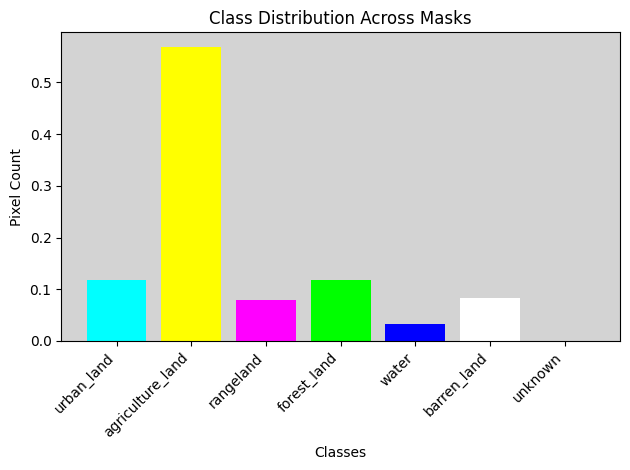

Proportion of agriculture: 0.5683575805473922


In [31]:
# define RGB -> class mapping...
class_colors = {
  (0, 255, 255): "urban_land",
  (255, 255, 0): "agriculture_land",
  (255, 0, 255): "rangeland",
  (0, 255, 0): "forest_land",
  (0, 0, 255): "water",
  (255, 255, 255): "barren_land",
  (0, 0, 0): "unknown",
}
# define RGB -> one hot encoding indices mapping...
color_indices = {
  (0, 255, 255): 0,  # urban_land
  (255, 255, 0): 1,  # agriculture_land
  (255, 0, 255): 2,  # rangeland
  (0, 255, 0): 3,    # forest_land
  (0, 0, 255): 4,    # water
  (255, 255, 255): 5, # barren_land
  (0, 0, 0): 6       # unknown
}

# find total class distribution across all training masks...
def count_class_pixels(masks):
  # stack masks into a single array of shape (N, H, W, num_classes)....
  masks_array = np.stack(masks, axis=0)

  # grab total number of classes...
  num_classes = masks_array.shape[-1]

  # initialize a list to count the occurrences of each class...
  class_counts = np.zeros(num_classes, dtype=int)

  # iterate over each pixel in each mask...
  for mask in masks_array:
    for pixel in mask.reshape(-1, num_classes):  # Reshape to (H*W, num_classes)
      class_index = np.argmax(pixel)  # grab the index of the class for each pixel...
      class_counts[class_index] += 1  # increment the count of class...

  return class_counts

# plot total class count distribution, color match to mapping...
def plot_class_pixel_counts(pixel_counts, class_colors, title):
  # extract colors and labels from the dictionary...
  bar_colors = [np.array(color) / 255.0 for color in class_colors.keys()]
  bar_labels = list(class_colors.values())

  # set up figure with background color for white...
  ax = plt.gca()
  ax.set_facecolor("#D3D3D3")

  # plot distribution proportions...
  plt.bar(bar_labels, pixel_counts/np.sum(pixel_counts), color=bar_colors)
  plt.xlabel("Classes")
  plt.ylabel("Pixel Count")
  plt.title("Class Distribution Across Masks")
  plt.xticks(rotation=45, ha="right")
  plt.tight_layout()
  plt.show()

# gather class distribution...
class_pixel_counts = count_class_pixels(y_train_masks)
print("Class pixel counts:", class_pixel_counts)

# print total number of pixels counted...
total_pixels_counted = np.sum(class_pixel_counts)
print("Total number of pixels counted:", total_pixels_counted)

# plot class distribution...
plot_class_pixel_counts(class_pixel_counts, class_colors, "Class Distribution Across Masks")

# log proportion of agriculture for reference...
print(f"Proportion of agriculture: {class_pixel_counts[1]/total_pixels_counted}")

The training data shows that land cover is overwhelmingly comprised of agricultural land, with all other classes following significantly behind. Given such a strong representation of a single class, I want to be sure the model does not form a strategy to predict only agricultural land.

It may be wise to weight our classes in the case one of the classes, like `agricultural_land`, when one/a few are being overrepresented. Our World in Data finds that:
- Agricultural land comprises ~37% of all land cover
- Forest land comprises ~31% of all land cover

Agricultural land can be found in around 57% of the total pixels in training, which is *significantly greater* than the global average. This alone is not enough to intervene just yet, so long as our model continues to learn well past this threshold, we can assume it is learning to identify other land cover types.

While this particular dataset is composed of satellite imagery from around the globe, many of its images focusing on rural and semi-rural areas in Africa, South America and parts of Asia. These communities tend to lean more agricultural in nature, making the increased proportion of `agricultural_land` acceptable until proven otherwise.

# Model Training
The first few cells involve establishing and fitting the model. If you plan to load a model at this point, skip past model fitting and uncomment the calls to load in a previous model.
## Model Architecture
The model leverages a U-Net model implementation using TensorFlow/Keras for our image segmentation task. According to my research, this type of model is typically used for biology, medical and other fine image segmentation applications.

It is said to perform well with capturing both local (micro) and global (macro) features. The definition of the U-Net architecture is laid out in the following structure:
- Input
  - Establishes input size to the shape of our training images
  - Expects input of shape: (Width, Height, (R,G,B))
- Encoder / Contracting Path
  - Builds up the layers of convolutional layers/filters
  - The number of filters increases the depth of the image/feature map accordingly
  - Extracts spatial features; edges, textures, patterns, etc.
- Bottleneck
  - 'Lowest point' of the U-Net model used to extract deep features
  - Final translation to a max depth of 256 in the current model
- Decoder / Expansive Path
  - Aims to recover information from downsampling (encoding)
  - Integrates insights learned in each level into a combined feature map
- Output
  - Returns the overall feature map depth back to `num_classes` (7)
  - Ensures prediction output matches standard land cover masks
  - Softmax is preferred for pixel-wise class probabilities

## Model Definition
Declared using a dynamic learning rate; Adam (Adaptive Moment Estimation) prioritizes momentum or gradients formed in previous iterations. This aims to facilitate progress and accelerated convergence.

As the model trains, the learning rate is adjusted automatically to prevent overfitting. The small initial rate prevents forming strong opinions too quickly.

The loss function is categorical crossentropy using accuracy as the evaluation metric. This loss function is well-suited to multi-class segmentation where the model predicts pixel-by-pixel. It measures the difference between predicted probabilities and true class labels, penalizing incorrect predictions on a graduated scale according to the model's confidence.

In [60]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from sklearn.utils import class_weight

def unet_model(input_shape, num_classes):
  # defines the input shape to expect (H,W,RGB)...
  inputs = layers.Input(input_shape)

  # encoder; contracting path translates map to (W,H,64)...
  c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
  c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
  p1 = layers.MaxPooling2D((2, 2))(c1)

  # encoder; contracting path translates map to (W,H,128)...
  c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
  c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
  p2 = layers.MaxPooling2D((2, 2))(c2)

  # bottleneck; max depth (W,H,256)...
  c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
  c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c3)

  # decoder; expansive path translates map to (W,H,128)...
  u4 = layers.UpSampling2D((2, 2))(c3)
  u4 = layers.concatenate([u4, c2], axis=-1)
  c4 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(u4)
  c4 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c4)

  # decoder; expansive path translates map to (W,H,64)...
  u5 = layers.UpSampling2D((2, 2))(c4)
  u5 = layers.concatenate([u5, c1], axis=-1)
  c5 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u5)
  c5 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c5)

  # returns output to (W,H,7), with softmax activation...
  outputs = layers.Conv2D(num_classes, (1, 1), activation='softmax')(c5)

  model = models.Model(inputs=[inputs], outputs=[outputs])
  return model

# Define input shape and number of classes
input_shape = X_train_images[0].shape
num_classes = len(class_colors)

# initialize the model...
model = unet_model(input_shape, num_classes)
optimizer = Adam(learning_rate=1e-4, clipnorm=1.0)

# compile the model...
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# plot summary...
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 512, 512, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_22 (Conv2D)        │ (None, 512, 512, 64)   │          1,792 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_23 (Conv2D)        │ (None, 512, 512, 64)   │         36,928 │ conv2d_22[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 256, 256, 64)   │              0 │ conv2d_23[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_24 (Conv2D)        │ (None, 256, 256, 128)  │         73,856 │ max_pooling2d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_25 (Conv2D)        │ (None, 256, 256, 128)  │        147,584 │ conv2d_24[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_5           │ (None, 128, 128, 128)  │              0 │ conv2d_25[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_26 (Conv2D)        │ (None, 128, 128, 256)  │        295,168 │ max_pooling2d_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_27 (Conv2D)        │ (None, 128, 128, 256)  │        590,080 │ conv2d_26[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_4           │ (None, 256, 256, 256)  │              0 │ conv2d_27[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_4             │ (None, 256, 256, 384)  │              0 │ up_sampling2d_4[0][0], │
│ (Concatenate)             │                        │                │ conv2d_25[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_28 (Conv2D)        │ (None, 256, 256, 128)  │        442,496 │ concatenate_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_29 (Conv2D)        │ (None, 256, 256, 128)  │        147,584 │ conv2d_28[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_5           │ (None, 512, 512, 128)  │              0 │ conv2d_29[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_5             │ (None, 512, 512, 192)  │              0 │ up_sampling2d_5[0][0], │
│ (Concatenate)             │                        │                │ conv2d_23[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_30 (Conv2D)        │ (None, 512, 512, 64)   │        110,656 │ concatenate_5[0][0]    │
├──────────────────────

 Total params: 1,883,527 (7.19 MB)

 Trainable params: 1,883,527 (7.19 MB)

 Non-trainable params: 0 (0.00 B)

## Applying Augmentations
To apply augmentations on the fly (ie: between training epochs), we package our previous augmentation strategy within a helper that packages our training and test data and applies augmentations to increase the diversity of our training set.

Either comment this section out and move forward with the original dataset, or uncomment and train our model using the dynamic image augmentation strategy. Just as before, this process is computationally taxing and can simply be left to TensorFlow in-built methods to integrate with our model efficiently.

In [61]:
''' implementation of tensor dataset for augmentations between epochs... '''
# apply same augmentations seen earlier...
def augment(image, mask):
  # random horizontal flip...
  h_flip = tf.random.uniform([], 0, 1) > 0.5
  image = tf.cond(h_flip, lambda: tf.image.flip_left_right(image), lambda: image)
  mask = tf.cond(h_flip, lambda: tf.image.flip_left_right(mask), lambda: mask)
  #image = tf.image.random_flip_left_right(image)
  #mask = tf.image.random_flip_left_right(mask)

  # random vertical flip...
  v_flip = tf.random.uniform([], 0, 1) > 0.5
  image = tf.cond(v_flip, lambda: tf.image.flip_up_down(image), lambda: image)
  mask = tf.cond(v_flip, lambda: tf.image.flip_up_down(mask), lambda: mask)
  #image = tf.image.random_flip_up_down(image)
  #mask = tf.image.random_flip_up_down(mask)

  # random 90-degree rotation...
  k = tf.random.uniform(shape=[], minval=0, maxval=4, dtype=tf.int32)
  image = tf.image.rot90(image, k=k)
  mask = tf.image.rot90(mask, k=k)

  # random brightness/contrast (images only)...
  image = tf.image.random_brightness(image, max_delta=0.2)
  image = tf.image.random_contrast(image, lower=0.8, upper=1.2)

  return image, mask

# package into tensorflow dataset...
def create_dataset(X, y, target_size=(512, 512), batch_size=8, apply_augment=False):
  def preprocess(img, mask):
    # resize images and masks to the target size...
    img = tf.image.resize(img, target_size)
    mask = tf.image.resize(mask, target_size)
    return img, mask

  dataset = tf.data.Dataset.from_tensor_slices((X, y))
  dataset = dataset.map(lambda img, mask: preprocess(img, mask))

  if augment:
    dataset = dataset.map(augment, num_parallel_calls=tf.data.AUTOTUNE)

  dataset = dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)
  return dataset

## Model Parameters
Now that the model architecture is defined, the model can finally be trained/fit to our data. To prevent our model from overfitting, we leverage early stopping and another level of dynamic learning rate adjustments.

While the `Adam` implementation of adaptive learning rates applied directly to each parameter internally, the `ReduceLROnPlateau` implementation looks at our model's learning at a macro scale. The former is reassessed parameter by parameter, increasing and decreasing learning rates according to it's confidence and progress rates. The latter acts globally, ensuring slower learning rates once learning progress slows. This action aims to hone in on fine adjustments as our model begins to converge.

A second model fitting approach was also defined in an attempt to apply TensorFlow augmentations between training epochs. Initial testing showed diminished performance, further exploration of this approach will be explored (time willing).

Epoch 1/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 23s 186ms/step - accuracy: 0.4510 - loss: 2.3665 - val_accuracy: 0.6245 - val_loss: 1.2122 - learning_rate: 1.0000e-04
Epoch 2/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/step - accuracy: 0.5658 - loss: 1.3167 - val_accuracy: 0.6304 - val_loss: 1.1540 - learning_rate: 1.0000e-04
Epoch 3/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/step - accuracy: 0.5918 - loss: 1.2048 - val_accuracy: 0.6374 - val_loss: 1.1261 - learning_rate: 1.0000e-04
Epoch 4/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/step - accuracy: 0.6132 - loss: 1.1787 - val_accuracy: 0.6572 - val_loss: 1.0518 - learning_rate: 1.0000e-04
Epoch 5/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/step - accuracy: 0.6258 - loss: 1.1359 - val_accuracy: 0.6604 - val_loss: 1.0274 - learning_rate: 1.0000e-04
Epoch 6/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/step - accuracy: 0.6433 - loss: 1.0904 - val_accuracy: 0.6815 - val_loss: 0.9897 - learning_rate: 1.0000e-04
Epoch 7/100
81/81 ━━━━━━━━━━━━━━━━━━━━ 11s 135ms/ste

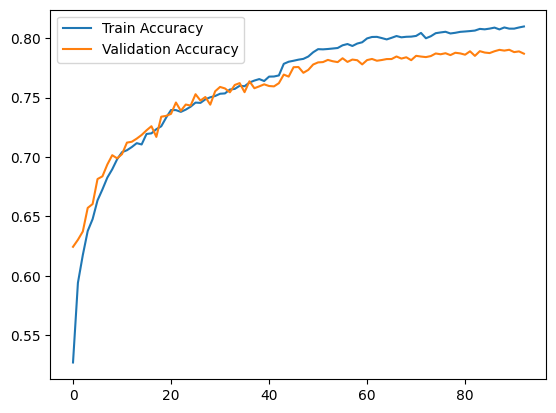

In [62]:
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ReduceLROnPlateau

# leverage early stopping and dynamic larning rates to prevent overfitting...
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

''' model fitting for self-defined image processing... '''
"""history = model.fit(
  X_train_images,
  y_train_masks,
  epochs=100,
  batch_size=8,
  validation_data=(X_test_images, y_test_masks),
  callbacks=[early_stopping, lr_scheduler]
)"""

''' model fitting for tensorflow image processing... '''
# generate datasets...
train_dataset = create_dataset(X_train_images, y_train_masks, apply_augment=True)
val_dataset = create_dataset(X_test_images, y_test_masks, apply_augment=False)

history = model.fit(
  train_dataset,
  epochs=100,
  batch_size=8,
  validation_data=val_dataset,
  callbacks=[early_stopping, lr_scheduler]
)

# check training history for accuracy and loss...
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')

plt.legend()
plt.show()

## Model Prediction
Optionally **save** and/or **load** a trained/fit model for forming prediction masks. Uncomment the combination of lines that suits your current needs before proceeding to generate predictions on our test images.

In [63]:
os.makedirs("/content/models", exist_ok=True)
model.save("/content/models/standard_1209_0115.keras")
#files.upload()
#model = load_model("/content/standard_1208_0915.keras")

# make predictions...
predictions = model.predict(X_test_images)
print("predictions shape:", predictions.shape)

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 180ms/step
predictions shape: (161, 512, 512, 7)


### Visualizing the Predictions
The first function below, `convert_predictions_to_colors`, gathers the predicted color mask for each pixel, applying the inverse mapping to reassign the RGB tuple value to each pixel, rather than the one hot encoded indexing.

The second, `plot_overlay_with_predictions`, accepts an image index, test image, and truth mask and plots an array of images for each prediction; the original satellite image, the model's predicted land cover mask overlay, and the true land cover mask overlay.

In [64]:
# mapping ohe indexing to RBG vals...
inverse_mapping = {
  0: (0, 255, 255),  # urban_land
  1: (255, 255, 0),  # agriculture_land
  2: (255, 0, 255),  # rangeland
  3: (0, 255, 0),    # forest_land
  4: (0, 0, 255),    # water
  5: (255, 255, 255), # barren_land
  6: (0, 0, 0)       # unknown
}

# decode ohe predictions to color mask coloration...
def convert_predictions_to_colors(predictions, mapping, verbose=True):
  # collect predicted class index [0-7] for each pixel (2D array)...
  predicted_classes = np.argmax(predictions, axis=-1)  # Shape: (256, 256)

  # place mapping colors into a list in their respective index...
  color_list = np.array([mapping[i] for i in sorted(mapping.keys())])

  if verbose:
    print("predicted_classes shape:", predicted_classes.shape)
    print("color_list:", np.array(color_list))

  # np.take replaces each class index to its color in list...
  color_predictions = np.take(color_list, predicted_classes, axis=0)
  return color_predictions

# plot array of images/mask overlays for visual comparison...
def plot_overlay_with_predictions(index_img=0, images=X_test_images, true_masks=y_test, predictions=None, inverse_mapping=None, verbose=True):
  # load the true mask...
  img = plt.imread(true_masks[index_img])

  # resize image to match predicted mask, if it was downsized...
  if img.shape[:2] != predictions[index_img].shape[:2]:
      img = cv.resize(img, (predictions[index_img].shape[1], predictions[index_img].shape[0]))

  # get the predicted color map from predictions...
  predicted_colors = convert_predictions_to_colors(predictions[index_img], inverse_mapping, verbose=verbose)

  # create a figure and axe...
  fig, axs = plt.subplots(1, 3, figsize=(24, 8))

  # plot satellite image...
  axs[0].imshow(images[index_img])
  axs[0].set_title(f"Sat Image [{index_img}]")
  axs[0].axis('off')

  # plot overlay of predicted mask on satellite image...
  axs[1].imshow(images[index_img])
  axs[1].imshow(predicted_colors, alpha=0.3)  # Adjust alpha to control transparency of the overlay
  axs[1].set_title("Predicted Overlay")
  axs[1].axis('off')

  # plot overlay of true mask on satellite image...
  axs[2].imshow(images[index_img])
  axs[2].imshow(img, alpha=0.3)
  axs[2].set_title("True Overlay")
  axs[2].axis('off')

  # show the plot...
  plt.show()

The model predictions are converted to prediction masks of a valid shape 166 masks of the correct dimensions. The `color_list` shows the RGB values that were used to map the predictions.

In [65]:
# convert predicted ohe masks to RGB masks...
predicted_mask = convert_predictions_to_colors(predictions, inverse_mapping, verbose=True)

predicted_classes shape: (161, 512, 512)
color_list: [[  0 255 255]
 [255 255   0]
 [255   0 255]
 [  0 255   0]
 [  0   0 255]
 [255 255 255]
 [  0   0   0]]


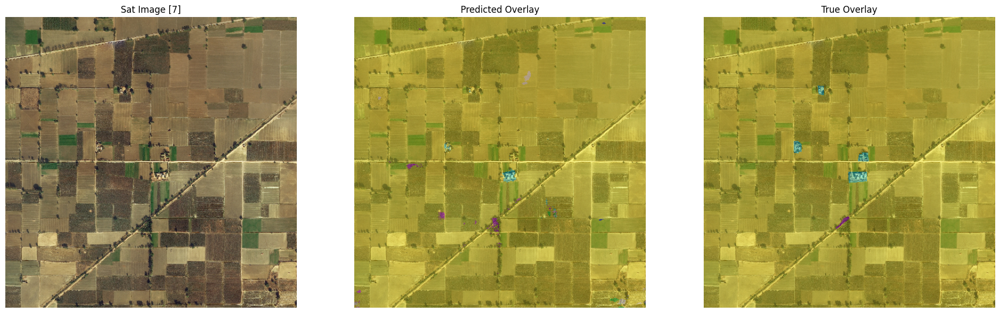

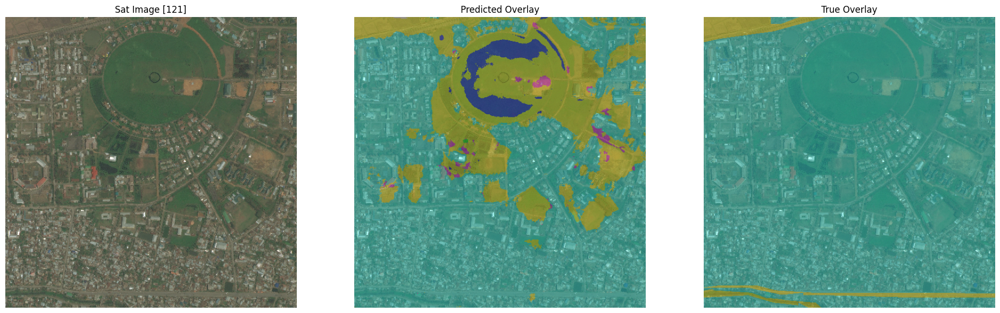

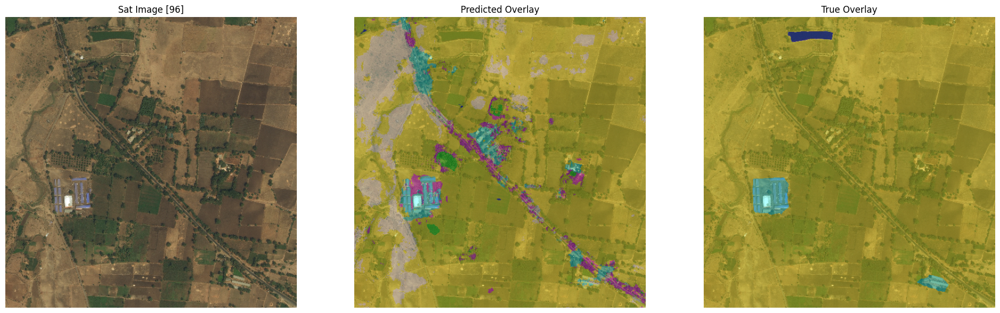

In [66]:
for i in random.sample(range(len(X_test_images)), 3):
  plot_overlay_with_predictions(index_img=i, images=X_test_images, predictions=predictions, true_masks=y_test, inverse_mapping=inverse_mapping, verbose=False)


(+) more discerning of urban/range relationship


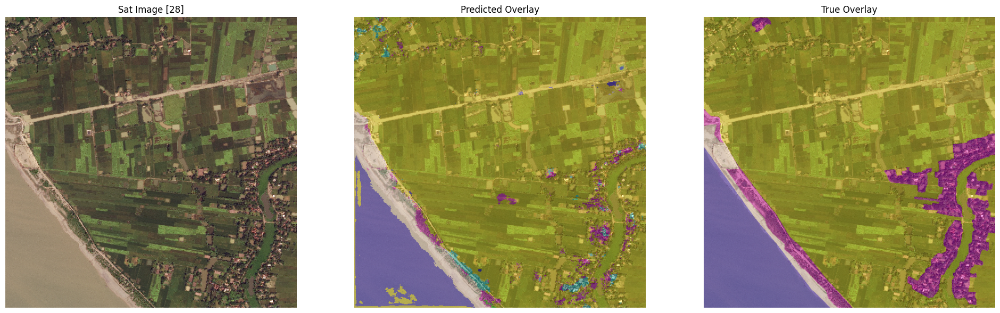

(+/-) more dicerning of urban boundary, possibly misclassifying rangeland


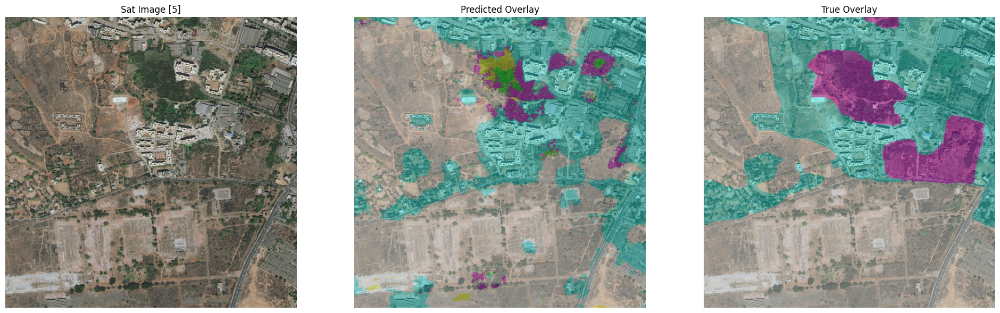

(-) pixel-wise prediction may be too targeted


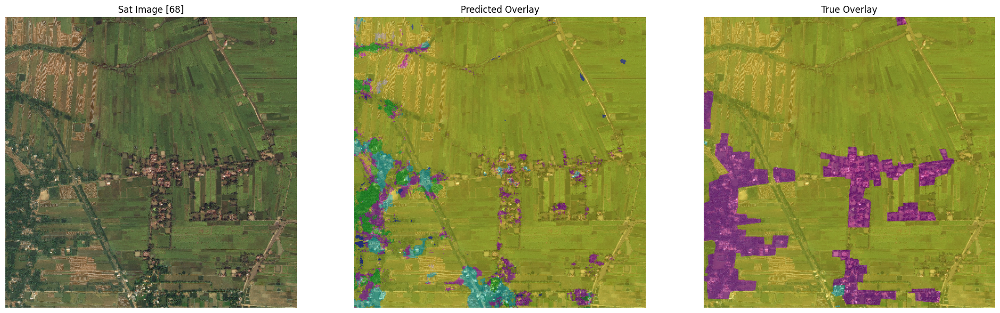

(-) confused rocky terrain as urban construction


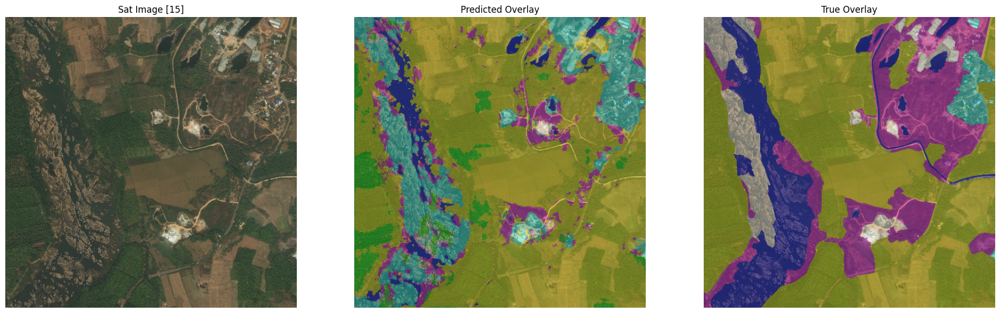

(-) confused with diverse water conditions


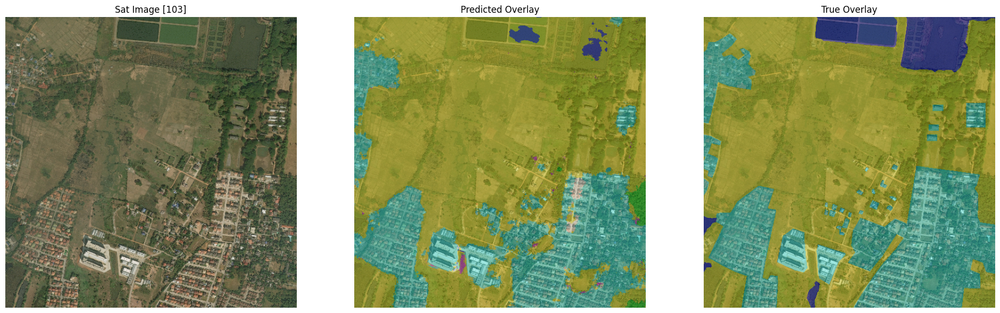

(-) confused with water segmentation in general


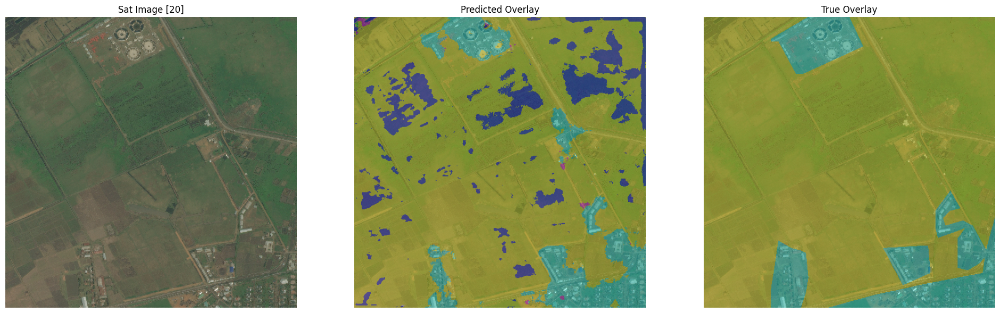

(+/-) over specificity/lack of detail in truth mask


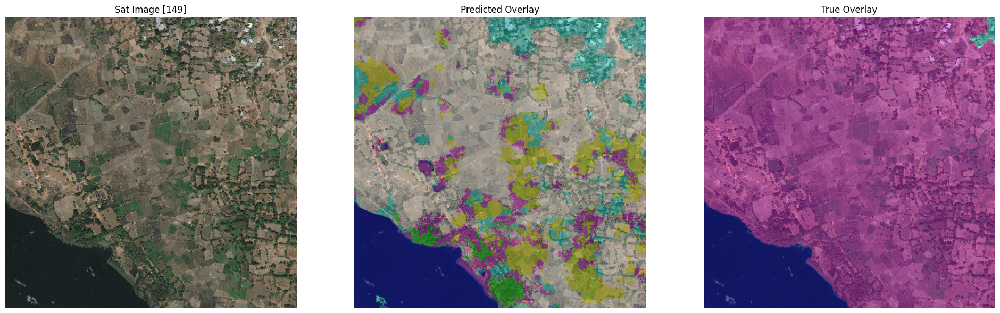

(+/-) detects forested islands while missing the river


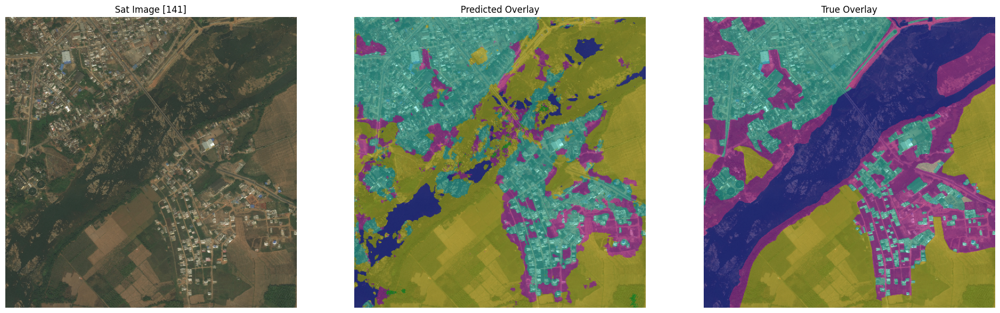

In [67]:
cherry_picks = {
  "(+) more discerning of urban/range relationship": 28,
  "(+/-) more dicerning of urban boundary, possibly misclassifying rangeland": 5,
  "(-) pixel-wise prediction may be too targeted": 68,
  "(-) confused rocky terrain as urban construction": 15,
  "(-) confused with diverse water conditions": 103,
  "(-) confused with water segmentation in general": 20,
  "(+/-) over specificity/lack of detail in truth mask": 149,
  "(+/-) detects forested islands while missing the river": 141
}

for key, val in cherry_picks.items():
  print(key)
  plot_overlay_with_predictions(index_img=val, images=X_test_images, predictions=predictions, true_masks=y_test, inverse_mapping=inverse_mapping, verbose=False)

# Reflections
Overall the model designed and trained in this notebook provide a promising proof of concept for an effective land cover classification model. Using 25% downsampled images and limited preprocessing/augmentation were able to achieve around 80% accuracy on our validation images.

Once proven, the model was expanded to incorporate random augmentations on the training data to increase the diversity of training images. While this new training approach did not make considerable progress in terms of accuracy, it smoothed the overall training/validation prediction significantly.

I suspect the impact of this approach is downplayed on our dataset that is relatively uniform across all image exposure, shape, hue, etc. I would argue that this new model would be significantly better suited at handling satellite imagery which exhibits more variability.

Standard Model Training (no augmentation)


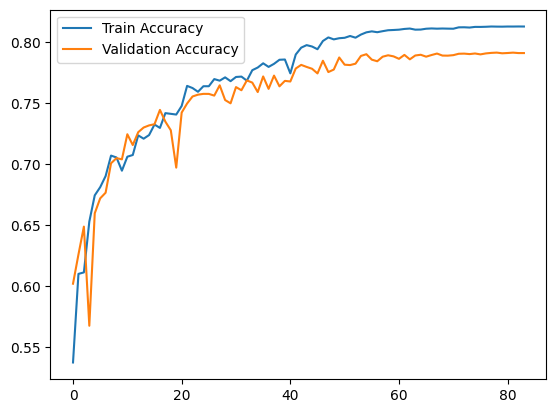

Augmented Model Training


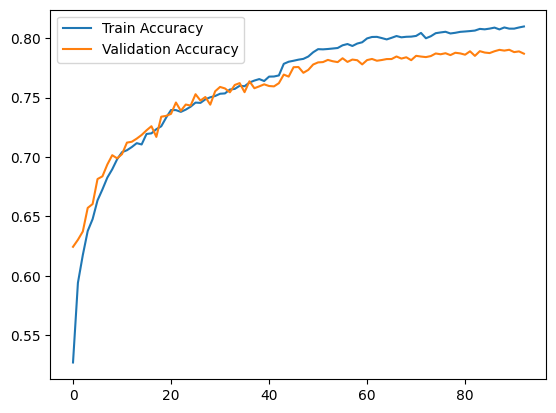

In [73]:
files.upload() # standard training...
files.upload() # augmented training...

print("Standard Model Training (no augmentation)")
display(Im('/content/performance.png'))

print("Augmented Model Training")
display(Im('/content/performance_aug.png'))

## Prediction Analysis
Overall the model seemed to work fairly well on simple data, predicting urban land cover quite well. It struggled in a few understandable areas:
- Water Bounday Detection
- Urban/Forest Edge Detection

Comparing the model predictions to the truth masks, it is clear that the model struggles most with segmenting water correctly. Misclassifying situations where water was both present and absent. Also evident is the diverse spectrum of water color, clarity and hue.

The model also seems to frequently misclassify urban edge conditions to be range land, with a similar issue arising with forest edges and/or savannah conditions. The source defines **rangeland** to be "any green land that is not classified as forest or farmland". In other words, occupying the transition zones between urban/agriculture, urban/forest and agriculture/forest.

In both cases the error is reasonably justifiable given the flexible decision boundary between land cover types. Image augmentation and additional layers of data, such as LiDar, to enrich the visual data and ideally improve overall model performance.

## Training Error
In the process of hand selecting images for presentation, I encountered several cases of seemingly flawed land masking throughout the training and testing set.
Many of the images found had errors with water detection and in many cases omitted many boundary cases that the trained model struggled to correctly identify.

The original dataset's masks were generated by professional annotators who were able to leverage domain knowledge to outperform many automated processes, "particularly in distinguishing subtle variations in land cover types like rangelands and barren lands."

Large river and human dwellings misclassified as agriculture


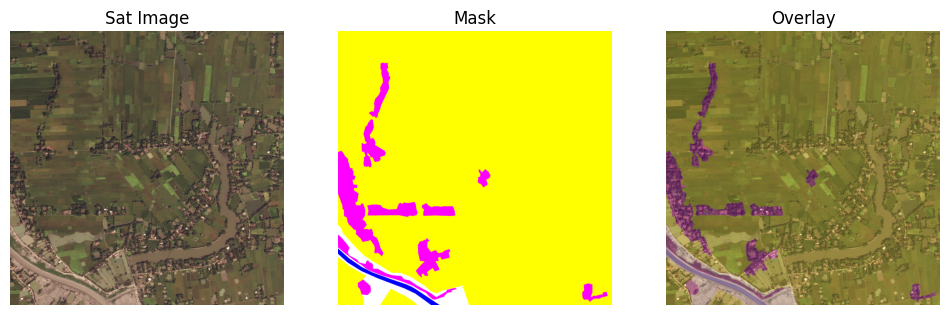

Large river misclassified  as agriculture


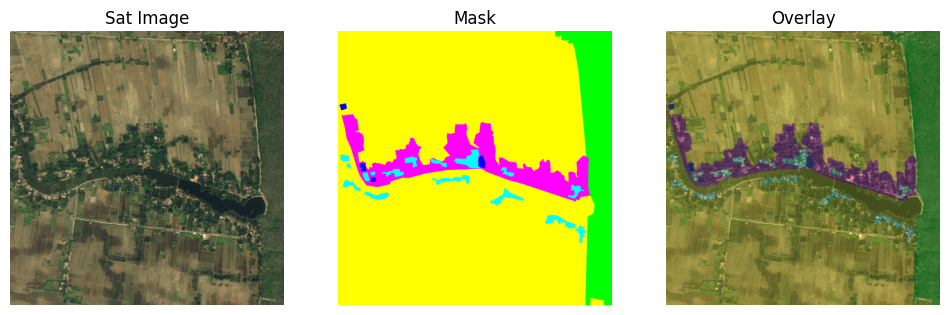

Human dwellings misclassified as rangeland


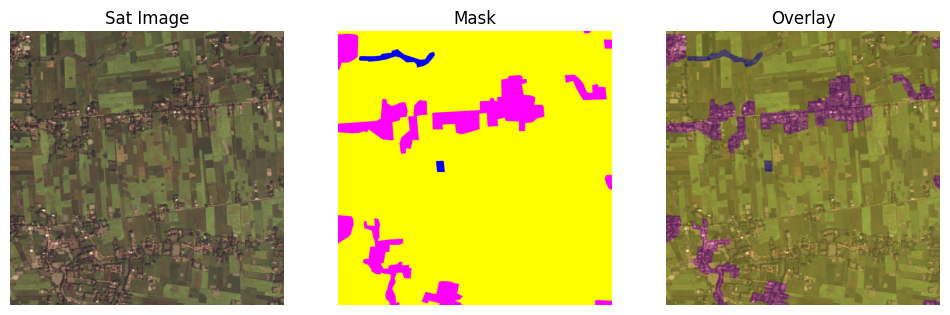

Sinous river misclassified as agriculture


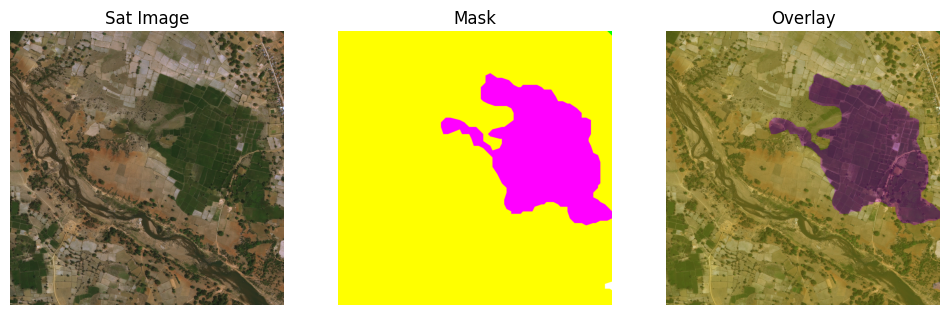

Airport tarmac and adjacent barren land misclassified as agriculture


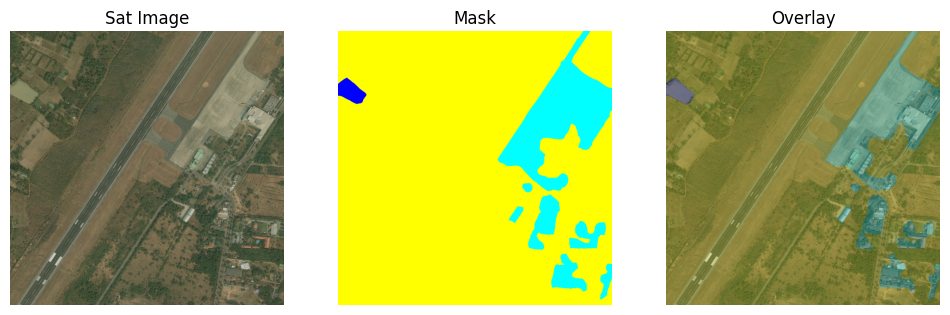

Possible over generalization of forest/range land


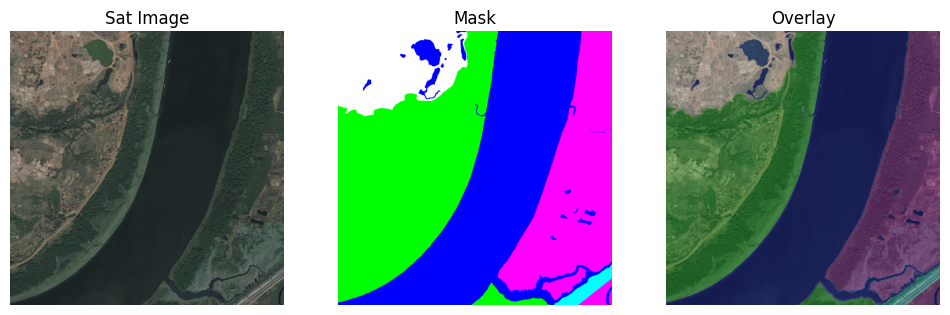

In [74]:
flagged_masks = [346,296,338,63,380,510]
flagged = {
  510: "Large river and human dwellings misclassified as agriculture",
  346: "Large river misclassified  as agriculture",
  338: "Human dwellings misclassified as rangeland",
  63: "Sinous river misclassified as agriculture",
  380: "Airport tarmac and adjacent barren land misclassified as agriculture",
  296: "Possible over generalization of forest/range land",
}

#for i in random.sample(range(len(train_data_paths)), 20):
for key,val in flagged.items():
  print(f"{val}")
  plot_overlay(index_img=key)

As eluded to during our EDA process, the training data can sometimes appear to misclassify and/or confuse land cover types. While the source asserts that the land covers were conducted by a professional to ensure greater accuracy than automated means, this also opens the door for human-error.

I am not debating the validity of the training data, nor is that part of the scope of this project. I mean to only shed light on classification differences between the dataset and my personal experience tapping into my extensive time spent practicing landscape architecture.

The dataset is small enough that I was hesitant to cull these samples from consideration, but the issues are prevalent enough for consideration in assessing our model's performance. Especially when one considers the areas of contention seem to correspond to the areas of confusion in the model's performance.

## Outcome
In brief, the U-Net model exceeded my expectations in many aspects of this land cover segmentation task. The model proved reliably effective and classifying visually distinct land cover types, while expectedly struggling in areas that benefit most from domain familiarity.

More advanced logic and/or imaging tools (ie: LiDar) would provide a new depth of information that would target quantifiable differences between difficult to distinguish areas.